In [1]:
# The folder where the script is saved will be your working directory

In [2]:
import numpy as np  # similiar to library() but with 'as' you shorten its commands
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import glob
import bbknn
from pandas.core.index import RangeIndex

In [3]:
sc.settings.verbosity = 3   # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()  # Logging version number is important to keep track of for research purposes
sc.settings.set_figure_params(dpi=80)

scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.10 numpy==1.17.2 scipy==1.2.2 pandas==0.25.1 scikit-learn==0.21.3 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


In [4]:
adata1 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P2P21CellCount03.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')   

adata2 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P2P21CellCount04.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')   

adata3 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P2P21CellCount05.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')   

adata4 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P2P21CellCount06.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32') 

adata5 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P2P21CellCount07.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')   

adata6 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P2P21CellCount08.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')  

adata7 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P21Wound.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')   

adata8 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P22Wound.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')   

adata9 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P23Wound.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')   

adata10 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P211Wound.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')   

adata11 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P212Wound.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')   

adata12 = sc.read_loom(
   '/media/driskelllab/RRD Poetry/Sequence/ImportantREnvironments/FinalEnvironments/P213Wound.loom',
    sparse=True, cleanup=False, X_name='spliced',
obs_names='CellID',
var_names='Gene', dtype='float32')   

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [5]:
adata1.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata2.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata3.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata4.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata5.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata6.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata7.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata8.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata9.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata10.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata11.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

adata12.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

In [6]:
adataP2 = adata1.concatenate(adata2,adata3, batch_key='batch', batch_categories=['batch3','batch4','batch5'])

adataP21 = adata4.concatenate(adata5,adata6, batch_key='batch', batch_categories=['batch6','batch7','batch8'])

adataP2wound = adata7.concatenate(adata8,adata9, batch_key='batch', batch_categories=['batch9','batch10','batch11'])

adataP21wound = adata10.concatenate(adata11,adata12, batch_key='batch', batch_categories=['batch12','batch13','batch14'])

adata = adataP2.concatenate(adataP21,adataP2wound,adataP21wound, batch_key='Time', batch_categories=['P2','P21','P2Wound','P21Wound'])



In [7]:
adata

AnnData object with n_obs × n_vars = 67664 × 31045 
    obs: 'Clusters', 'Time', '_X', '_Y', 'batch'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

normalizing by total count per cell
    finished (0:00:03): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


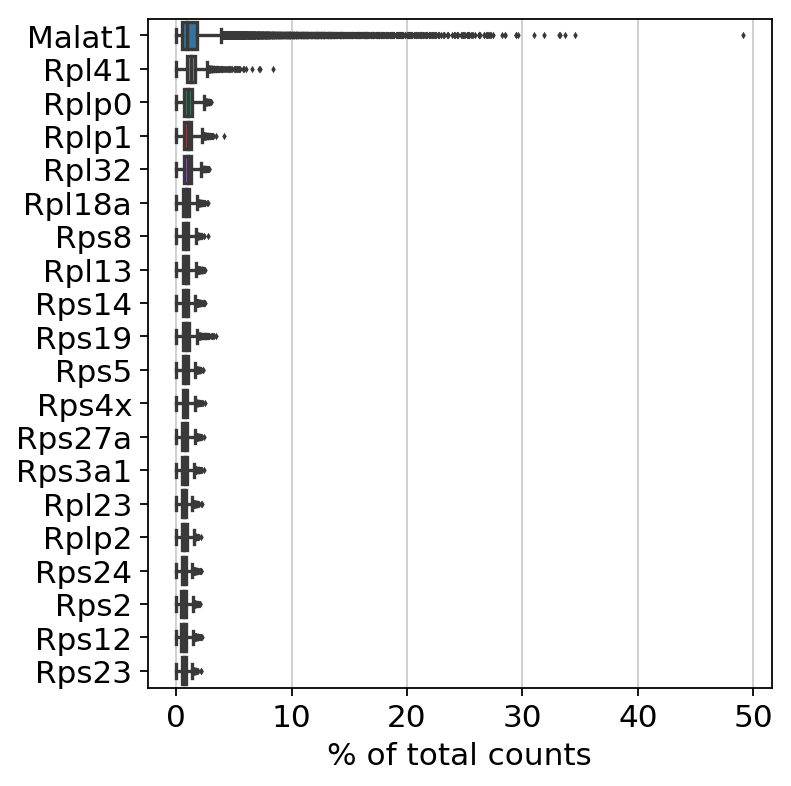

In [8]:
sc.pl.highest_expr_genes(adata, n_top=20)

In [9]:
sc.pp.filter_cells(adata, min_genes=200) # Basic filtering for removing genes that are expressing in less than 3 cells
sc.pp.filter_genes(adata, min_cells=3)

filtered out 615 cells that haveless than 200 genes expressed
filtered out 9823 genes that are detectedin less than 3 cells


In [10]:
mito_genes = adata.var_names.str.startswith('mt') # 'mt' here is lower case, because it's mice. in the tutorial is 'MT' because of human dataset. ifor each cell compute fraction of counts in mito genes vs. all genes
adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1 # the `.A1` is only necessary as X is sparse (to transform to a dense array after summing) puts the percentages of each cell into an array instead of an individual sparse
adata.obs['n_counts'] = adata.X.sum(axis=1).A1 # add the total counts per cell as observations-annotation (metadata) to adata.

... storing 'batch' as categorical
... storing 'Chromosome' as categorical
... storing 'Strand' as categorical


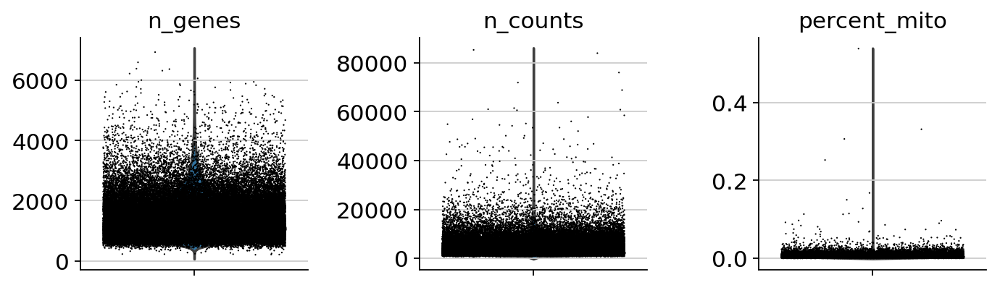

In [11]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],
             jitter=0.4, multi_panel=True)

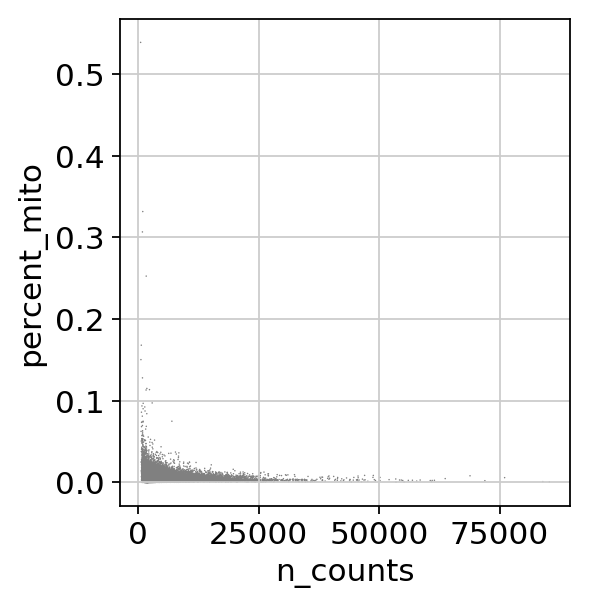

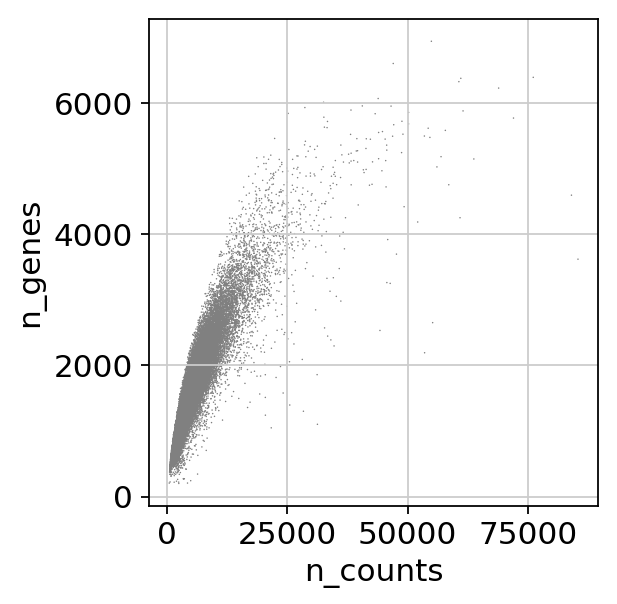

In [12]:
sc.pl.scatter(adata, x='n_counts', y='percent_mito')
sc.pl.scatter(adata, x='n_counts', y='n_genes')

In [13]:
adata = adata[adata.obs.n_genes < 6000, :]
adata = adata[adata.obs.percent_mito < 0.05, :]

In [14]:
sc.pp.normalize_total(adata, target_sum = None) # n_Count cell normalization. Makes it so that the gene expression in each cell doesn't overpower the expression of lesser expressed genes
# if target_sum = None then the medium of n_counts/reads per cell is assigned to all cells to have counts comparable among all cells 

Normalizing counts per cell.
    finished (0:00:00):normalized adata.X


In [15]:
sc.pp.log1p(adata)

/home/driskelllab/anaconda3/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:285: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(data)


In [16]:
sc.pp.highly_variable_genes(adata, n_top_genes=2000) # Identifying highly variable genes

extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


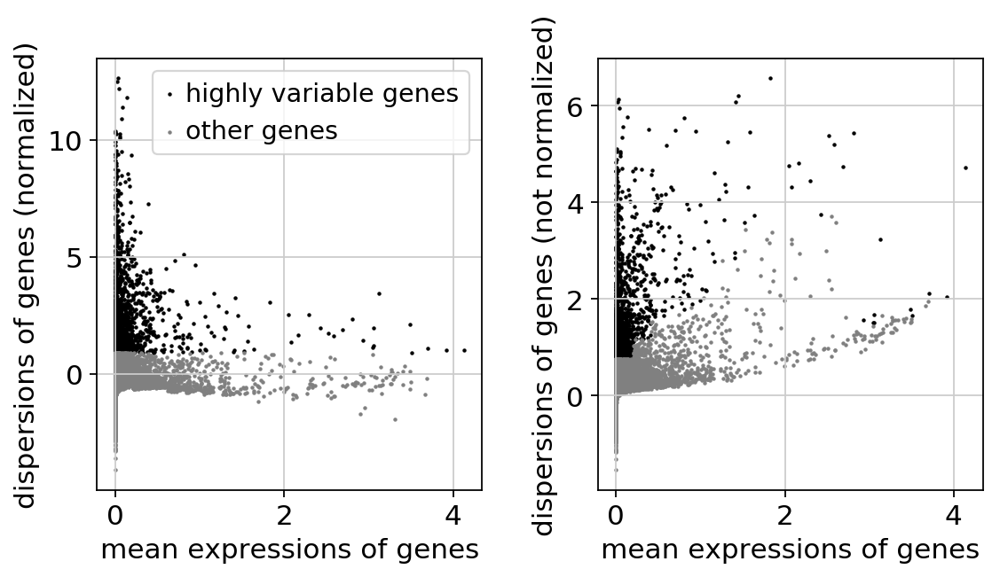

In [17]:
sc.pl.highly_variable_genes(adata)

In [18]:
#sc.pp.regress_out(adata, ['n_counts', 'percent_mito']) # Regressing out total counts per cell and percent.mt before scaling

In [19]:
sc.pp.scale(adata, max_value=10) # Scaling, takes all your genes and makes sure that they do not overpower other genes in all cells.

In [20]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:08)


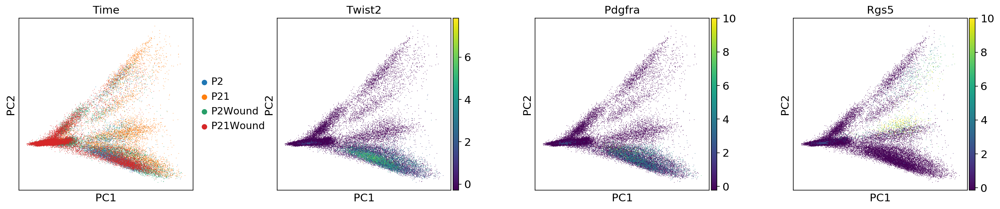

In [21]:
sc.pl.pca(adata, color=['Time', 'Twist2', 'Pdgfra', 'Rgs5'], wspace=0.35) # color literally means color a gene

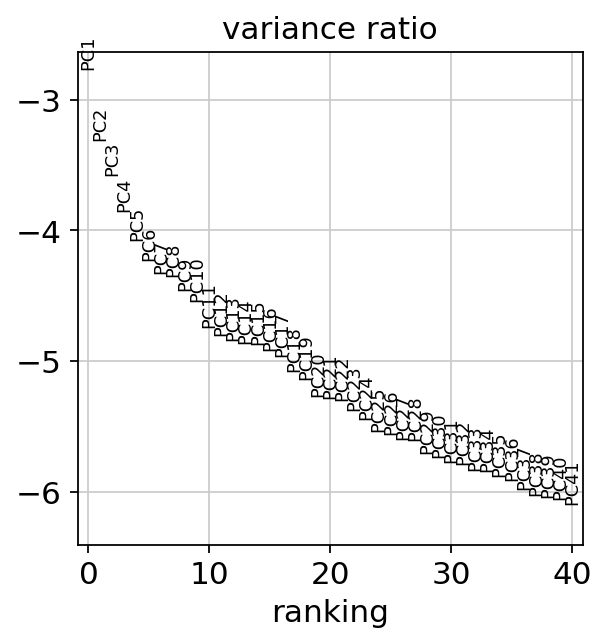

In [22]:
sc.pl.pca_variance_ratio(adata, n_pcs=40, log=True)

In [23]:
adata

AnnData object with n_obs × n_vars = 66987 × 21222 
    obs: 'Clusters', 'Time', '_X', '_Y', 'batch', 'n_genes', 'percent_mito', 'n_counts'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'Time_colors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [24]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=37)

computing neighbors
    using 'X_pca' with n_pcs = 37


/home/driskelllab/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../anaconda3/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  self.func_ir.loc))
/home/driskelllab/anaconda3/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../anaconda3/lib/python3.7/site-packages/umap/utils.py", line 4

    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:13)


In [25]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:09)


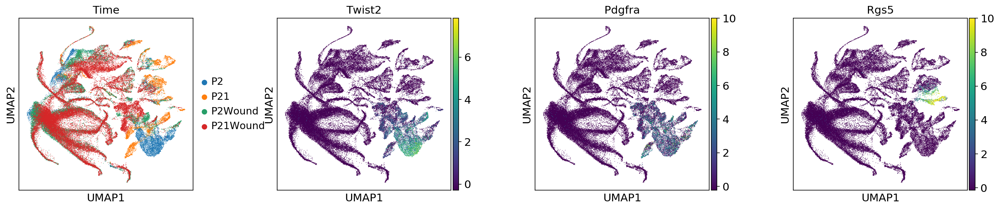

In [26]:
sc.pl.umap(adata, color=['Time', 'Twist2', 'Pdgfra', 'Rgs5'], wspace=0.35)

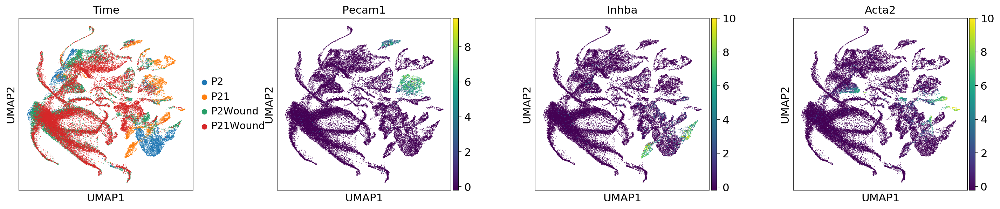

In [27]:
sc.pl.umap(adata, color=['Time', 'Pecam1','Inhba','Acta2'], use_raw=False, wspace=0.35)

In [28]:
sc.tl.louvain(adata, resolution=0.2) # Clustering/Neighbors

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 19 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:08)


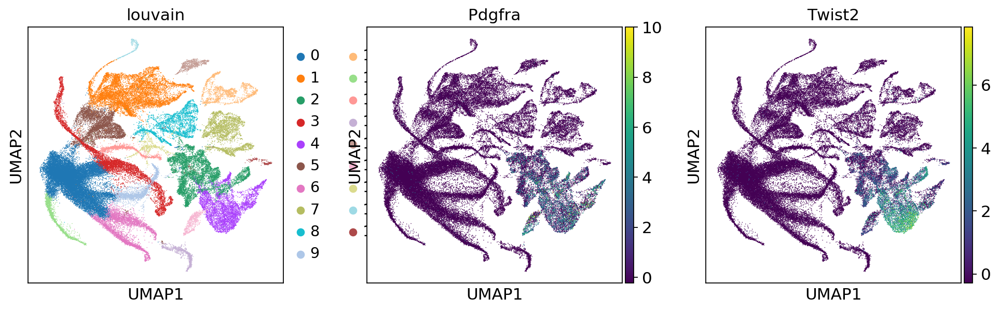

In [29]:
sc.pl.umap(adata, color=['louvain', 'Pdgfra', 'Twist2'])

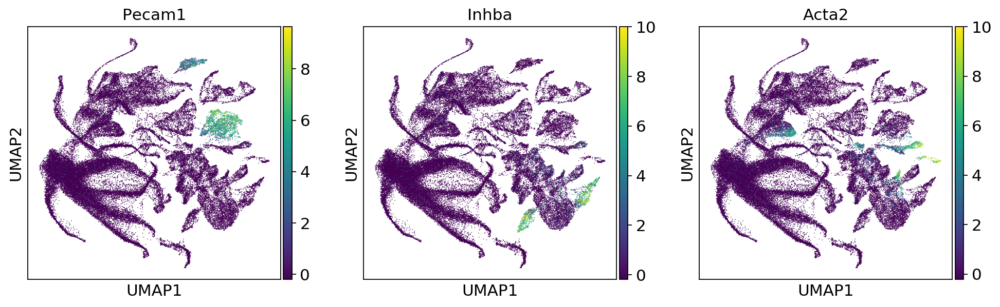

In [30]:
sc.pl.umap(adata, color=['Pecam1','Inhba','Acta2'])

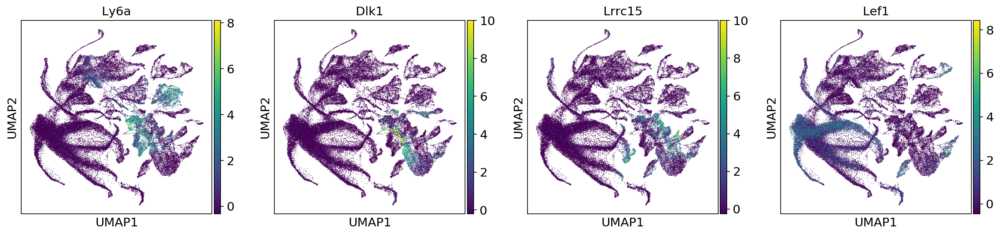

In [31]:
sc.pl.umap(adata, color=['Ly6a','Dlk1','Lrrc15','Lef1'])

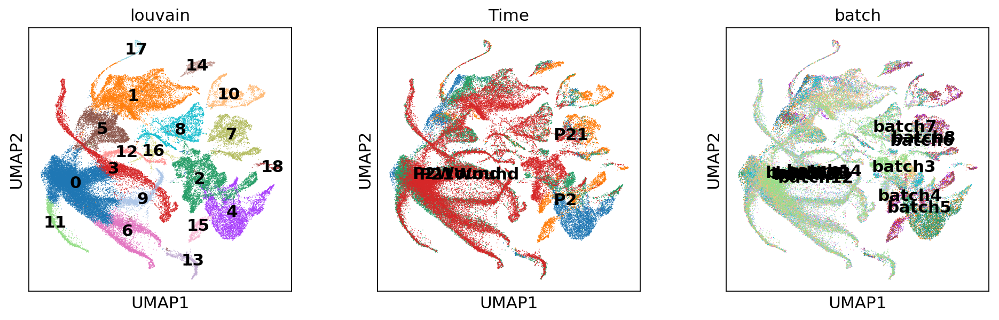

In [32]:
sc.pl.umap(adata, color=['louvain','Time','batch'], legend_loc='on data')

In [33]:
#####SUBSETTING THE DATA#####

In [34]:
adata_subset = adata[adata.obs['louvain'].isin(
    ['2','4','15'])]

In [35]:
adata_subset

View of AnnData object with n_obs × n_vars = 11386 × 21222 
    obs: 'Clusters', 'Time', '_X', '_Y', 'batch', 'n_genes', 'percent_mito', 'n_counts', 'louvain'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'Time_colors', 'neighbors', 'louvain', 'louvain_colors', 'batch_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [36]:
sc.tl.pca(adata_subset, svd_solver='arpack')

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:02)


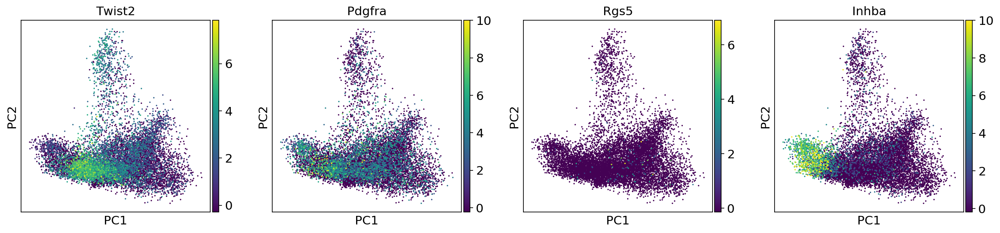

In [37]:
sc.pl.pca(adata_subset, color=['Twist2', 'Pdgfra', 'Rgs5','Inhba'])

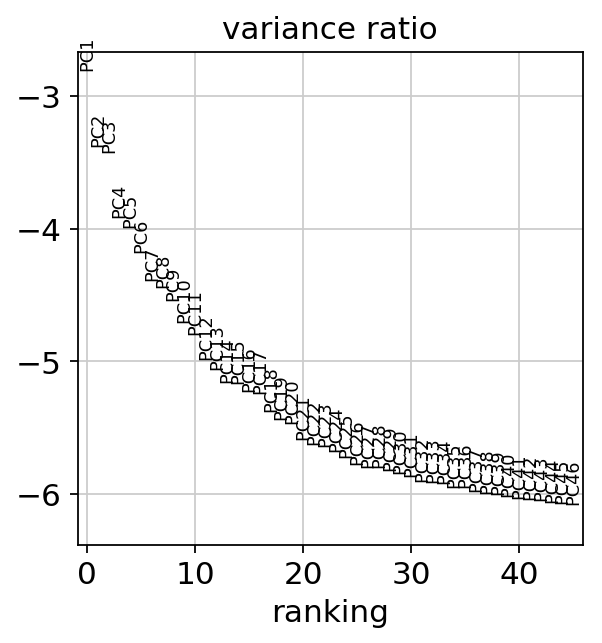

In [38]:
sc.pl.pca_variance_ratio(adata_subset, n_pcs=45, log=True)

In [39]:
bdata = bbknn.bbknn(adata_subset,batch_key='Time',copy=True)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix (0:00:01)


In [40]:
sc.tl.umap(bdata, min_dist=0.25, spread=2)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)


In [41]:
sc.pp.neighbors(bdata, n_neighbors=20, n_pcs=20)

computing neighbors
    using 'X_pca' with n_pcs = 20


/home/driskelllab/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:03)


In [42]:
#sc.tl.umap(adata_subset)

In [43]:
#sc.tl.louvain(bdata)

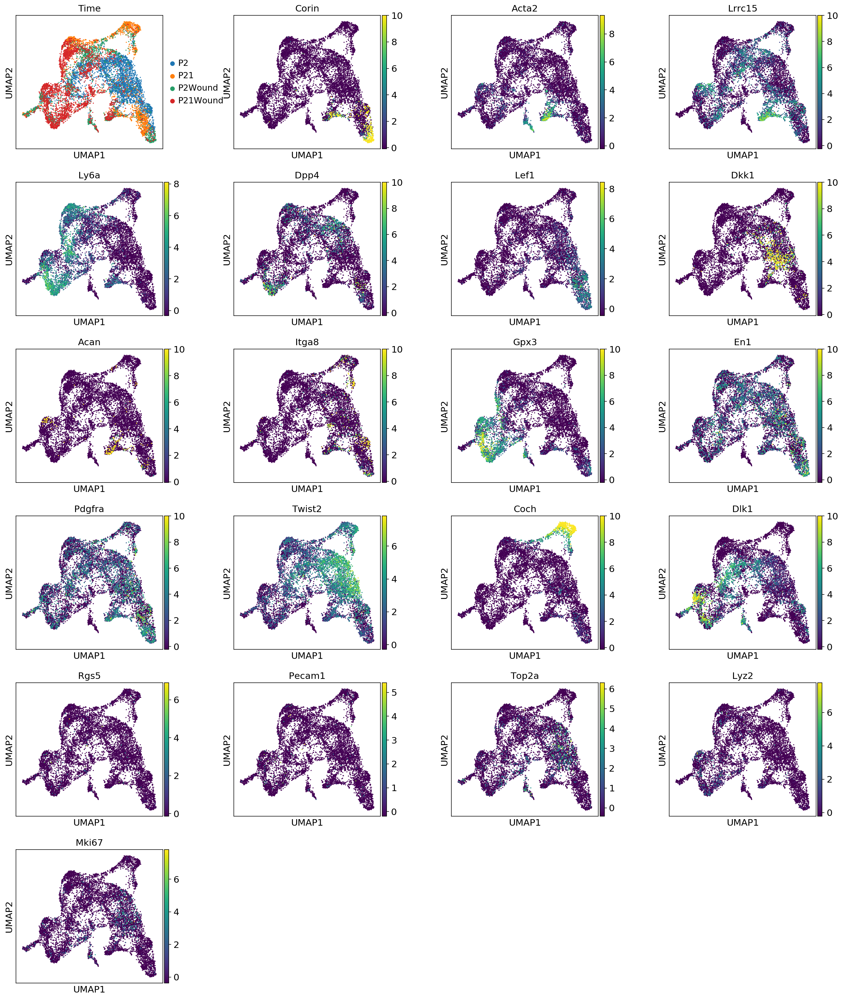

In [44]:
sc.pl.umap(bdata, color=['Time','Corin','Acta2','Lrrc15','Ly6a','Dpp4','Lef1','Dkk1','Acan','Itga8',
                        'Gpx3','En1','Pdgfra','Twist2','Coch','Dlk1','Rgs5','Pecam1','Top2a','Lyz2',
                        'Mki67'], 
           color_map= 'viridis',
           wspace=0.35)

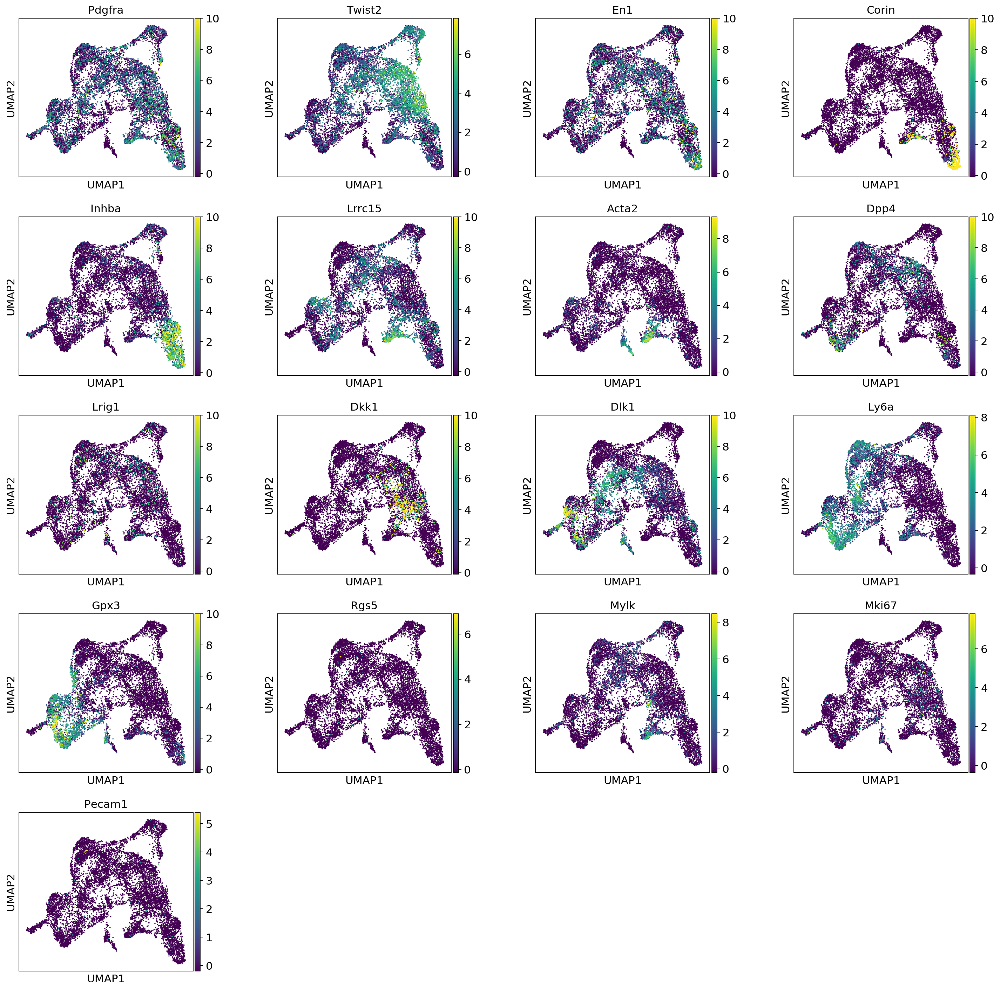

In [45]:
sc.pl.umap(bdata, color=['Pdgfra','Twist2','En1','Corin','Inhba','Lrrc15','Acta2','Dpp4','Lrig1',
                'Dkk1','Dlk1','Ly6a','Gpx3','Rgs5','Mylk','Mki67','Pecam1'], 
           color_map= 'viridis',
           wspace=0.35)

In [58]:
new_cluster_names = [
    '0 P2 PAP',
'1 Ly6a 1', 
'2 Dlk1Ly6a',
'3 Ly6a 3',
'4 Coch',
'5 DPP4kinda',
'6 DPDS',
'7 DP',
'8 DS',
'9 myofibro',
]
bdata.rename_categories('louvain', new_cluster_names)

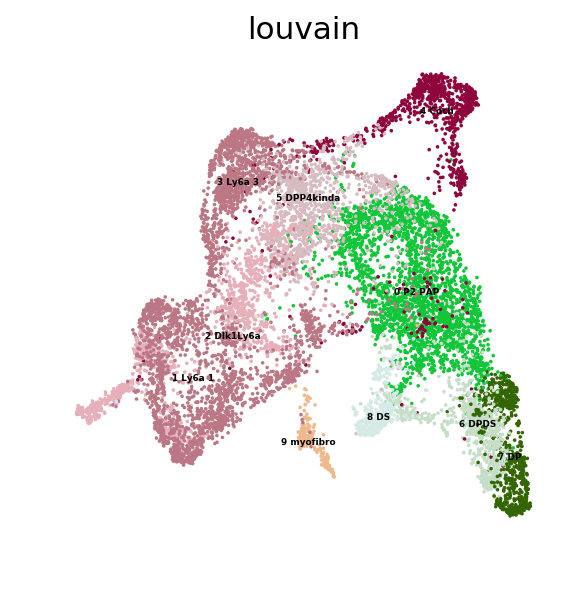

In [59]:
sc.pl.umap(bdata, color='louvain', legend_loc='on data', legend_fontsize='4.0',
           frameon=False)

In [48]:
sc.tl.louvain(bdata, resolution=0.2)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 10 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:01)


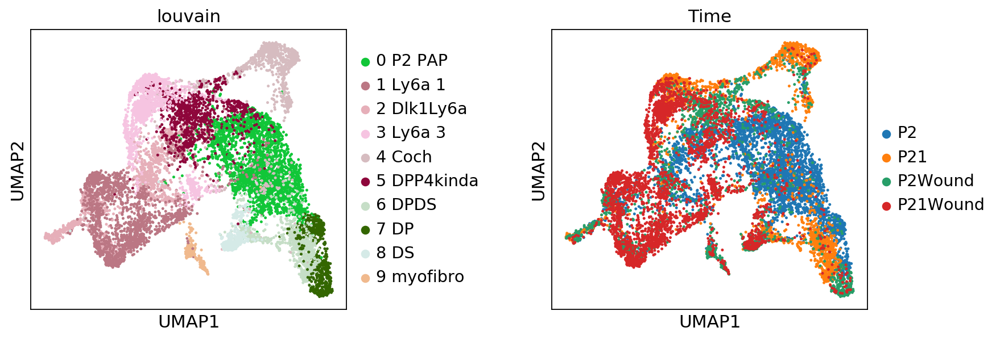

In [80]:
sc.pl.umap(bdata, color=['louvain','Time'], legend_loc='right margin', wspace=0.5, size=20)

In [50]:
###COLORING THE PLOT####

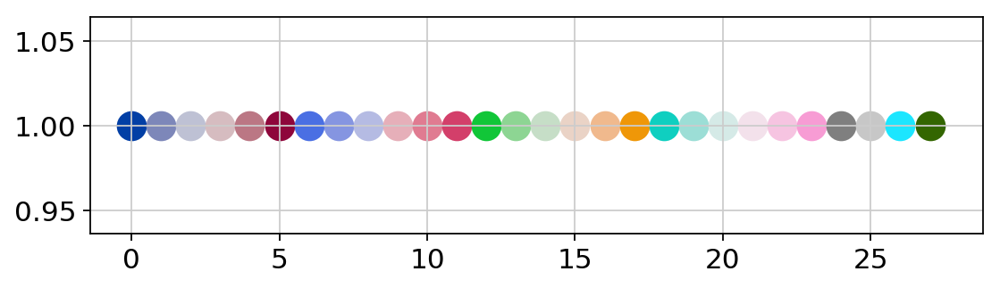

In [51]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
from matplotlib import rcParams
import scanpy as sc
pl.figure(figsize=(8, 2))
for i in range(28):
    pl.scatter(i, 1, c=sc.pl.palettes.zeileis_26[i], s=200)
pl.show()

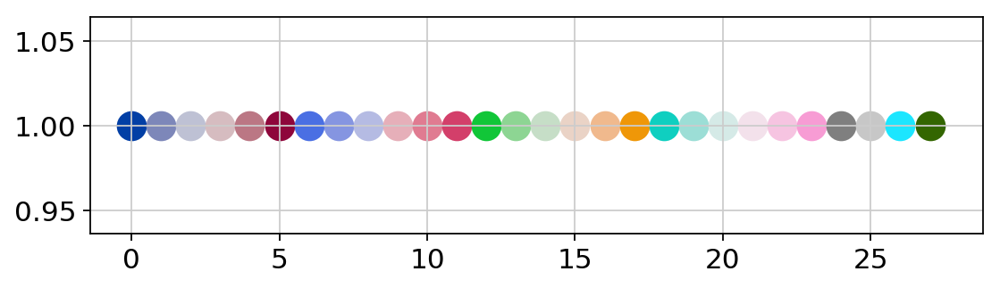

In [52]:
pl.figure(figsize=(8, 2))
for i in range(28):
    pl.scatter(i, 1, c=sc.pl.palettes.zeileis_26[i], s=200)
pl.show()

In [53]:
zeileis_colors = np.array(sc.pl.palettes.zeileis_26)
new_colors = np.array(bdata.uns['louvain_colors'])

In [69]:
new_colors[[0]] = zeileis_colors[[12]]  # '0 P2 PAP'
new_colors[[1]] = zeileis_colors[[4]]  #  1 Ly6a '
new_colors[[2]] = zeileis_colors[[9]]  # '2 Dlk1Ly6a',
new_colors[[3]] = zeileis_colors[[22]]  # 3 Ly6a 3
new_colors[[4]] = zeileis_colors[[3]]  # 4 Coch
new_colors[[5]] = zeileis_colors[[5]]  # 5 Dpp4kinda
new_colors[[6]] = zeileis_colors[[14]]  # 6 DPDS
new_colors[[7]] = zeileis_colors[[27]]  # 7 DP
new_colors[[8]] = zeileis_colors[[20]]  #  8 DS
new_colors[[9]] = zeileis_colors[[16]]  # 9 myofibro

In [70]:
bdata.uns['louvain_colors'] = new_colors

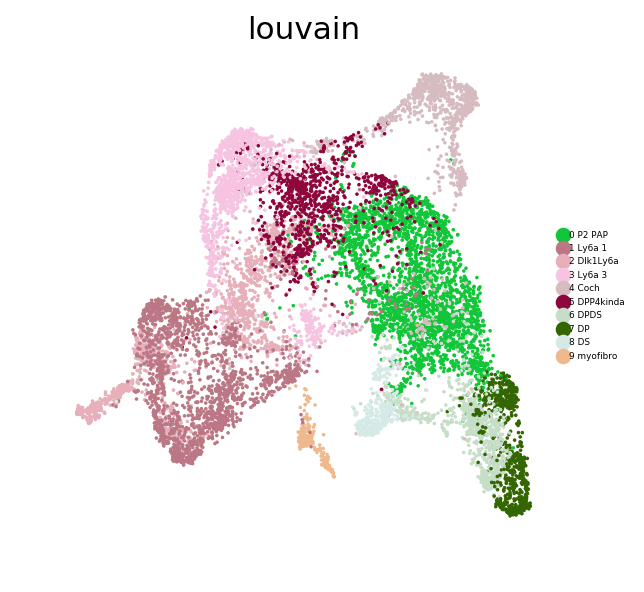

In [71]:
sc.pl.umap(bdata, color='louvain', legend_loc='right margin', legend_fontsize='4.0',
           frameon=False)

In [ ]:
bdata.obs.groupby(["louvain","batch"]).apply(len)

In [ ]:
P2P21fibroblastGerado = pd.DataFrame(bdata.obs.groupby(["louvain","batch"]).apply(len))

In [ ]:
P2P21fibroblastGerado.to_csv('/home/driskelllab/Desktop/P2P21fibroblastGerado.csv')

In [ ]:
sc.tl.rank_genes_groups(bdata, 'louvain', method='t-test')
sc.pl.rank_genes_groups(bdata, n_genes=25, sharey=False)

In [ ]:
adata_subset

In [ ]:
for gene in ['Lef1']:
    sc.pl.umap(bdata,color=gene, color_map='magma')

In [ ]:
adata_subset_nodiv = adata_subset[adata_subset.obs['louvain'].isin(['0', '1', '2', '3', '5', '6','7','8','9'])]

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
from matplotlib import rcParams
import scanpy as sc
pl.figure(figsize=(8, 2))
for i in range(28):
    pl.scatter(i, 1, c=sc.pl.palettes.zeileis_26[i], s=200)
pl.show()

In [ ]:
#sc.tl.diffmap(adata_subset, n_comps=5)
#sc.pp.neighbors(adata_subset, n_neighbors=20, use_rep='X_diffmap')

In [ ]:
#sc.tl.paga(adata_subset, groups='louvain', use_rna_velocity=False)

In [ ]:
#sc.pl.paga(adata_subset, color=['louvain','Time', 'Twist2', 'Lef1', 'Mki67', 'Ly6a','Coch'], threshold=0.03)

In [ ]:
#sc.tl.draw_graph(adata_subset, init_pos='paga')

In [ ]:
#sc.pl.draw_graph(adata_subset, color=['louvain','Time'], legend_loc='right margin', color_map='magma')

In [ ]:
#sc.pl.draw_graph(adata_subset, color=['Corin','Acta2','Mki67','Dpp4','Dlk1','Ly6a','Gpx3','Pdgfra'], legend_loc='right margin', color_map='viridis')

In [ ]:
#sc.pl.draw_graph(adata_subset, color=['Axin2','Dkk1','Tcf7','Lef1','Tcf7l1','Tcf7l2','Lrig1','En1'], color_map='viridis')

In [ ]:
from IPython.core.display import display, HTML # Switching tutorials over to RNA Velocity (scVelo)
display(HTML("<style>.container { width:90% !important; }</style>"))
%matplotlib inline

import scvelo as scv
scv.logging.print_version()

In [ ]:
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.set_figure_params('scvelo')  # for beautified visualization

In [ ]:
#scv.pp.filter_genes(bdata)
scv.pp.normalize_per_cell(bdata)
#scv.pp.filter_genes_dispersion(bdata)
scv.pp.log1p(bdata)

In [ ]:
#scv.pp.filter_and_normalize(bdata)
scv.pp.moments(bdata, n_pcs=30, n_neighbors=30)

In [ ]:
bdata

In [ ]:
scv.tl.velocity(bdata)

In [ ]:
scv.tl.velocity_graph(bdata)

In [ ]:
scv.pl.velocity_embedding_stream(bdata, basis='umap', color=['louvain', 'Time'], 
                                 frameon=True, legend_loc='on data')

In [ ]:
scv.pl.velocity_embedding_stream(bdata, basis='umap', vkey='velocity', 
                                 density=1.5, 
                                 smooth=None, 
                                    min_mass=1,
                                 cutoff_perc=None, arrow_color=None, linewidth=None, 
                                    n_neighbors=None, recompute=None, 
                                 color=['louvain','Time'], 
                                 use_raw=None, 
                                    layer=None, 
                                 color_map=True, 
                                 colorbar=True, 
                                    palette=None, 
                                 size=45, 
                                 alpha=0.8, 
                                 perc=None, 
                                    X=None, V=None, X_grid=None, V_grid=None, sort_order=True, 
                                    groups=None, components=None,
                                 legend_loc='right margin', 
                                    legend_fontsize=None, legend_fontweight=None, xlabel=None, 
                                    ylabel=None, title=None, 
                                    fontsize=None, figsize=None, dpi=300, 
                                    frameon=None, show=True, save=None, ax=None, ncols=None)

In [ ]:
scv.tl.rank_velocity_genes(bdata, match_with='louvain', n_genes=10000)

import pandas as pd
pd.DataFrame(bdata.uns['rank_velocity_genes']['names']).head(5000)

In [ ]:
p2p21diffgenesdata = pd.DataFrame(bdata.uns['rank_velocity_genes']['names'])

In [ ]:
p2p21diffgenesdata.to_csv('/home/driskelllab/Desktop/p2p21diffexp.csv')

In [ ]:
var_names = ['Lef1','Rspo3','Hhip','Wif1','Mef2c'] 
scv.pl.velocity(bdata, var_names=var_names, colorbar=True, basis='umap', ncols=2)

In [ ]:
scv.pl.velocity_embedding_grid(bdata, basis='umap', vkey='velocity', density=None, 
                               smooth=None, min_mass=None, arrow_size=5, arrow_length=1.5, 
                               arrow_color=None, scale=None, autoscale=True, n_neighbors=None, 
                               recompute=None, X=None, V=None, X_grid=None, V_grid=None, 
                               principal_curve=False, color=['louvain','Time'], use_raw=None, layer=None, 
                               color_map=None, colorbar=True, palette=None, size=20, alpha=0.4, 
                               perc=None, sort_order=True, groups=None, components=None, 
                               projection='2d', legend_loc='right margin', legend_fontsize=5, 
                               legend_fontweight=None, xlabel=None, ylabel=None, title=None, 
                               fontsize=None, figsize=None, dpi=300, frameon=None, show=True, 
                               save=None, ax=None, ncols=None)

In [ ]:
marker_genes = ['Pdgfra','Twist2','En1','Corin','Inhba','Lrrc15','Acta2','Dpp4','Lrig1',
                'Dkk1','Dlk1','Ly6a','Gpx3','Rgs5','Mylk','Mki67','Pecam1'
                 ]

In [ ]:
marker_genes2 = ['Pdgfra','Twist2','En1','Col1a1','Col1a2','Crabp1','Corin','Inhba','Lrrc15','Acta2','Dpp4','Lrig1',
                'Dkk1','Itga8','Dlk1','Ly6a','Gpx3','Coch','Mki67','Npnt'
                 ]

In [ ]:
ax = sc.pl.dotplot(bdata, marker_genes2, groupby='louvain', dendrogram=True)